# Assignment 2: Feature Extraction
### Samantha Handal - 260983914

# Setup
Imports & path variable declaration

In [19]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import skimage as ski

from google.colab import drive
drive.mount('/content/drive')

# path variable to my image library
path = '/content/drive/My Drive/ECSE415/Assignment_2/'

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# 1 - Harris Corner Detection
For this part of the assignment, you will examine the workings of the Harris corner detector. Implement the Harris corner detector as described in class (Lecture 5, Slide 48, and Tutorial 2&3) mainly using NumPy, going through each of the described steps:
1. Compute the image derivatives (optionally, blur first).
2. Compute the square of the derivatives.
3. Apply Gaussian Filtering on the output of Step 2.
4. Compute the cornerness function response: Determinant(H) − kTrace(H)^2, where k=0.05.
5. Perform non-maximum suppression.

Non-max suppression: [Source 1](https://towardsdatascience.com/non-maximum-suppression-nms-93ce178e177c), [Source 2](https://www.cs.ubc.ca/~lowe/425/slides/4-Edges.pdf), [Source 3](https://www.cs.cmu.edu/~16385/s17/Slides/6.2_Harris_Corner_Detector.pdf)

Classification of Points Based on Eigenvalues:

* **Corner**: If both eigenvalues are large, the intensity changes significantly in all directions, indicating a corner.
* **Edge**: If one eigenvalue is large and the other is small, the intensity changes significantly only in one direction, indicating an edge.
* **Flat**: If both eigenvalues are small, there is little change in intensity in any direction, indicating a flat region.

The cornerness response R helps to classify each point in the image:

- **Positive Large R**: Indicates a corner. If both eigenvalues are large, Det(H) will be large and Trace(H) will not be enough to reduce R significantly, even after being squared and multiplied by k. Therefore, a large positive R value signifies that a pixel lies on a corner where there are significant changes in gradient in all directions.

- **Negative or Small R**: Indicates an edge or a flat region. If one eigenvalue is small and the other is large (characteristic of an edge), Det(H) will be small because it is the product of one small and one large number. The Trace(H) will be relatively large because it is the sum of both eigenvalues, and k * Trace(H)^2 will suppress R to be negative or close to zero. For flat regions, both eigenvalues are small, and hence both Det(H) and Trace(H) are small, leading to a small R.

In [20]:
def harris_corner_detection(image, k=0.05, threshold=0.01, window_size=3):

    # Step 1: Compute the image derivatives
    # should I use the one on tut 3?
    Ix = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=3)
    Iy = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=3)

    # Step 2: Compute the square of the derivatives
    Ixx = Ix ** 2
    Iyy = Iy ** 2
    Ixy = Ix * Iy

    # Step 3: Apply Gaussian filtering on the output of step 2
    g_Ixx = cv2.GaussianBlur(Ixx, (5, 5), 0)
    g_Iyy = cv2.GaussianBlur(Iyy, (5, 5), 0)
    g_Ixy = cv2.GaussianBlur(Ixy, (5, 5), 0)

    # Step 4: Compute the cornerness function response, from class notes...
    #   har = det[μ(σI ,σD)] − k[trace(μ(σI ,σD))^2]
    #   har = g(Ixx)g(Iyy)−[g(Ixy)]^2 − k[g(Ixx)+g(Iyy)]^2
    det = g_Ixx * g_Iyy - g_Ixy ** 2
    trace = g_Ixx + g_Iyy
    har = det - k * (trace ** 2)

    # Step 5: Perform non-maximum suppression
    print("Min/Max λ−")
    print("Min: " + str(np.min(har)))
    print("Max: " + str(np.max(har)))
    print()

    # Defined and changed window size as another parameter, since we filter only high λ− values,
    # we then check the neighbourhood to verify that the point is a local max, but how do we define the
    # neighbourhood? Also played with neighbourhood size as another factor
    max = np.max(har)
    corners = np.zeros_like(image)
    offset = window_size // 2

    for i in range(offset, har.shape[0] - offset):
        for j in range(offset, har.shape[1] - offset):

            # Find points with large response (λ− > threshold)
            # Take λ− whose confidence is more than threshold% of the max λ−
            if har[i, j] > threshold * max:

                # defining neighborhood to search for local max
                neighborhood = har[i - offset:i + offset + 1, j - offset:j + offset + 1]

                # Choose those points where λ− is a local maximum as features
                if har[i, j] == np.max(neighborhood):
                    corners[i, j] = 1

    return corners

Printing logic

In [21]:
def print_harris_corners(image, threshold, window_size):

    # copy image
    image_disp = image.copy()

    # convert to grayscale
    image_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Run the Harris corner detection
    corners = harris_corner_detection(image_gray, k=0.05, threshold=threshold, window_size=window_size)

    # list all points higher than threshold
    loc = np.where(corners == 1.0)
    print("Number of corners detected: " + str(len(loc[0])))

    # loop though points
    for pt in zip(*loc[::-1]):
        # draw filled circle on each point
        # cv2.circle(img, center, radius, color[, thickness[, lineType[, shift]]]) → None
        cv2.circle(image_disp, pt, 2, (255,0,0), -1)

    # display images
    plt.figure(figsize=(10,10))
    plt.subplot(121), plt.imshow(image)
    plt.title("Input Image"), plt.xticks([]), plt.yticks([])
    plt.subplot(122), plt.imshow(image_disp)
    plt.title("Harris Corners"), plt.xticks([]), plt.yticks([])
    plt.show()

## Checkerboard Image

The checkerboard is an ideal subject for corner detection because it has clear, unambiguous corners where the black and white squares meet.

In analyzing the Harris corner detection results, the R matrix mostly consists of zero values with some patches of very negative, or very positive values. The zero values correspond to the flat regions inside the squares where there is minimal intensity variation. The checkerboard's regular, high-contrast corners produce patches of very positive R values, indicating the presence of distinct corners where the intensity changes abruptly in multiple directions. The significant negative R values indicates long edges without corners, which is characteristic of the checkerboard pattern.

Despite changing the threshold values, the number of detected corners remains the same (64). This consistency indicates that the corners in the checkerboard image are very distinct and the changes in brightness at the corners are significantly higher than the Harris detector threshold levels being tested. Since the corners are very distinct, the R matrix reflects this with very large numbers that are invariant to threshold changes.

Min/Max λ−
Min: -21141253125.0
Max: 95449454538.57422

Number of corners detected: 64


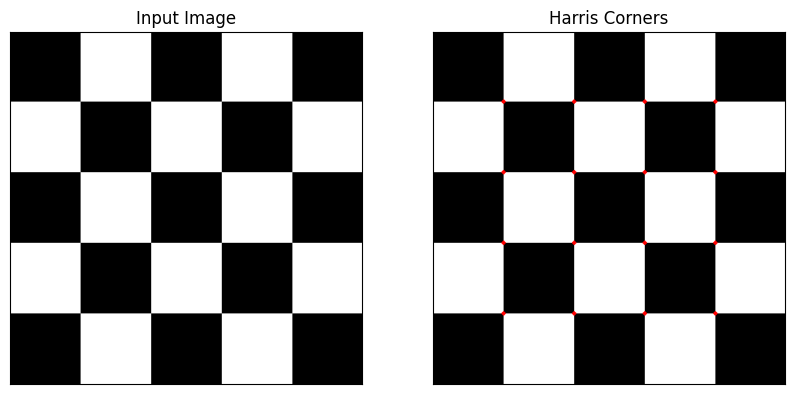

In [22]:
# load images from data folder
checkerboard = cv2.imread(path + "Data/Q1/checkerboard.png")
print_harris_corners(checkerboard, 0.01, 3)

Min/Max λ−
Min: -21141253125.0
Max: 95449454538.57422

Number of corners detected: 64


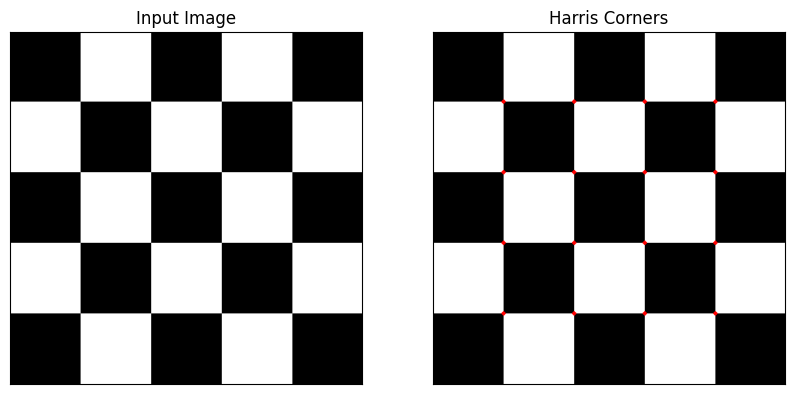

In [23]:
# load images from data folder
checkerboard = cv2.imread(path + "Data/Q1/checkerboard.png")
print_harris_corners(checkerboard, 0.005, 3)

Min/Max λ−
Min: -21141253125.0
Max: 95449454538.57422

Number of corners detected: 64


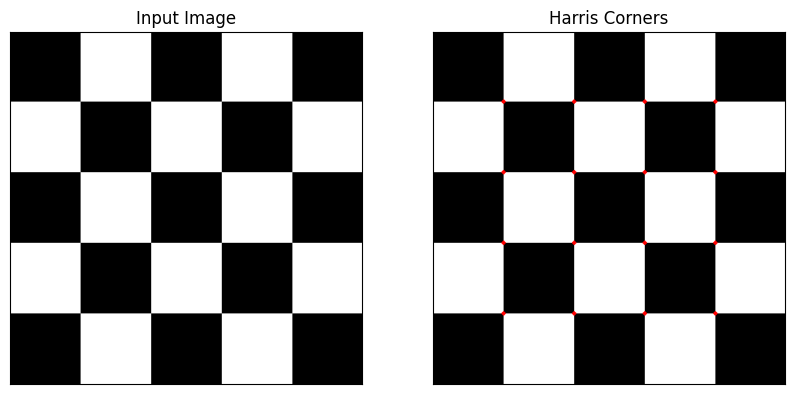

In [24]:
# load images from data folder
checkerboard = cv2.imread(path + "Data/Q1/checkerboard.png")
print_harris_corners(checkerboard, 0.5, 3)

## Building Image

A small note to add is that I also took into account window size for non-max supression, the window size determines the size of the neighborhood over which the algorithm computes the intensity gradient and the subsequent corner response. Including the window size as a parameter in the Harris corner detection process I thought was inportant because it directly influences the scale at which the algorithm identifies corners.

Changing the threshold value and the window size affects the detection of corners as follows:

* Threshold Value: The threshold determines the sensitivity of corner detection. A lower threshold will detect more corners, including weaker ones which may be due to noise or less prominent features. As the threshold increases, fewer corners are detected as the detector becomes less sensitive to subtle changes in the image, and only the most pronounced corners are identified.

* Window Size: The window size determines the area over which the local gradients are aggregated to compute the corner response. A larger window size may incorporate more noise into the corner response calculation but is better for detecting corners over larger areas. Conversely, a smaller window size focuses on finer details, which may be more suitable for high-resolution images or when looking for small, localized features.

From my tests:

* Threshold 0.005, Window Size 21: Detected 247 corners, indicating a lower threshold with a moderately large window size, capturing more corners including potentially noisier or less prominent ones.

* Threshold 0.01, Window Size 21: Detected 238 corners, which is slightly fewer, suggesting that increasing the threshold has started to exclude the less prominent corners.

* Threshold 0.02, Window Size 3: Detected 474 corners, a much larger count, which is unexpected as a higher threshold typically results in fewer corners. This suggests that the window size of 3 may be too small, detecting noise as corners or the scaling of the cornerness response may not be linear.

* Threshold 0.1, Window Size 3: Detected 700 corners, which further reinforces that the small window size is probably too sensitive to noise and image artifacts, leading to an over-detection of corner features.

In summary, the window size affects the scale at which corners are detected, and the threshold value controls the sensitivity of corner detection. By adjusting both parameters, one can fine-tune the corner detector to the specific features and scale of interest within an image. The ideal combination of these parameters depends on the image resolution, the scale of features to be detected, and the amount of noise present in the image.

Min/Max λ−
Min: -11777768543.850586
Max: 56275150127.31352

Number of corners detected: 700


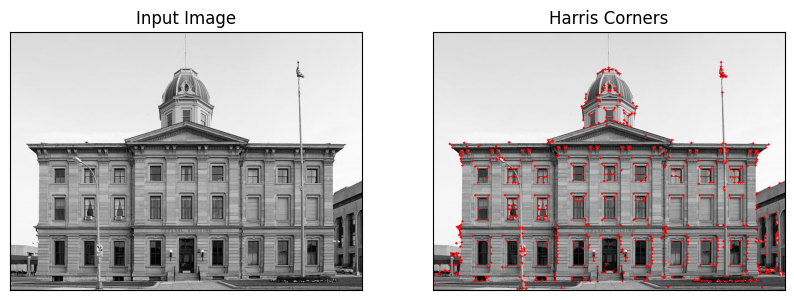

In [25]:
courthouse = cv2.imread(path + "Data/Q1/courthouse_gray.jpg")
print_harris_corners(courthouse, 0.01, 3)

Min/Max λ−
Min: -11777768543.850586
Max: 56275150127.31352

Number of corners detected: 474


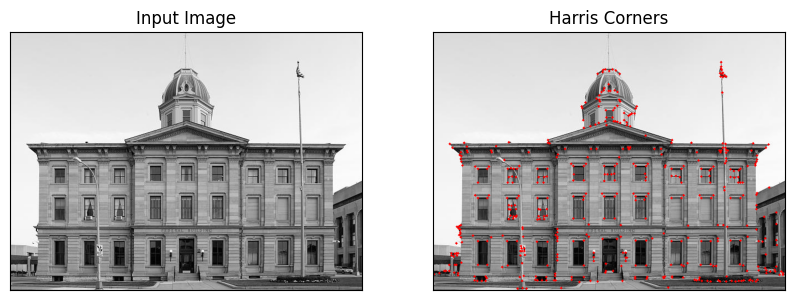

In [26]:
courthouse = cv2.imread(path + "Data/Q1/courthouse_gray.jpg")
print_harris_corners(courthouse, 0.02, 3)

Min/Max λ−
Min: -11777768543.850586
Max: 56275150127.31352

Number of corners detected: 238


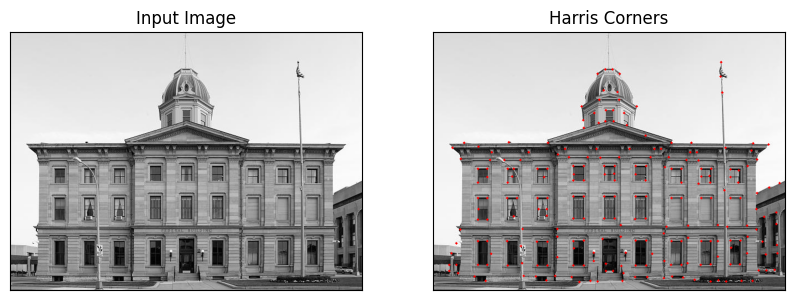

In [27]:
courthouse = cv2.imread(path + "Data/Q1/courthouse_gray.jpg")
print_harris_corners(courthouse, 0.01, 21)

Min/Max λ−
Min: -11777768543.850586
Max: 56275150127.31352

Number of corners detected: 247


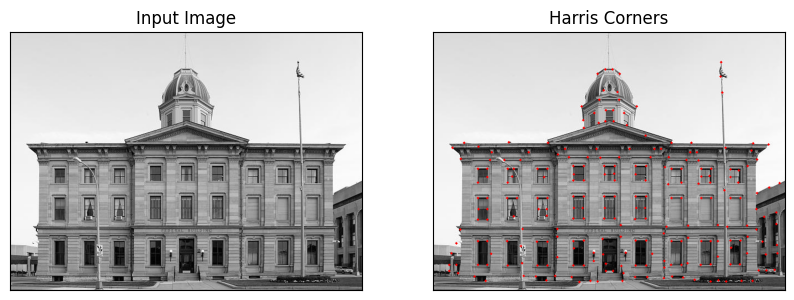

In [28]:
courthouse = cv2.imread(path + "Data/Q1/courthouse_gray.jpg")
print_harris_corners(courthouse, 0.005, 21)

# 2 - SIFT Features

## 2.1 - SIFT in a nutshell
### 1 - Generate a Scale-Space Image Pyramid
This is the initial step in the SIFT algorithm where an image is progressively blurred and resampled to produce a set of scale-space images. These images mimic the multi-scale characteristics of real-world objects. By doing this, the algorithm can detect keypoints that are invariant to changes in scale.
### 2 - SIFT key localization (feature detection)
The algorithm then searches through the scale-space pyramid to identify potential keypoints. These points are located at maxima and minima of the Difference of Gaussian images that are generated by subtracting one blurred image from another within an octave of the pyramid. The potential keypoints are those that are invariant to scale and orientation.
### 3 - Eliminate unstable keypoints
Many of the keypoints found in the previous step are not suitable for matching across different images due to their instability. This step involves refining the set of keypoints by eliminating those with low contrast (which are sensitive to noise) and those located along edges (which are poorly localized). This refinement process ensures that the keypoints that remain are robust to transformations and noise.
### 4 - Select a canonical orientation for the SIFT keypoint
Each keypoint is assigned one or more orientations based on local image gradient directions. This step is important for making sure that the descriptor is rotation invariant. The orientation is calculated by creating a histogram of local gradients and selecting the peak of this histogram as the keypoint’s orientation. If there are multiple peaks of similar magnitude, then multiple keypoints are created, each with a different orientation.

## 2.2 - SIFT between two different pictures

1. Compute SIFT keypoints for image_1 and image_2.
2. Match all keypoints between two images using a brute-force method.
3. Sort the matching keypoints according to the matching distance.
4. Display the top ten matched keypoints.
5. Plot the matching distance for the top 100 matched keypoints. Plot the indices of keypoints on the x-axis and the corresponding matching distance on the y-axis.

Logic taken from Tutorial 4

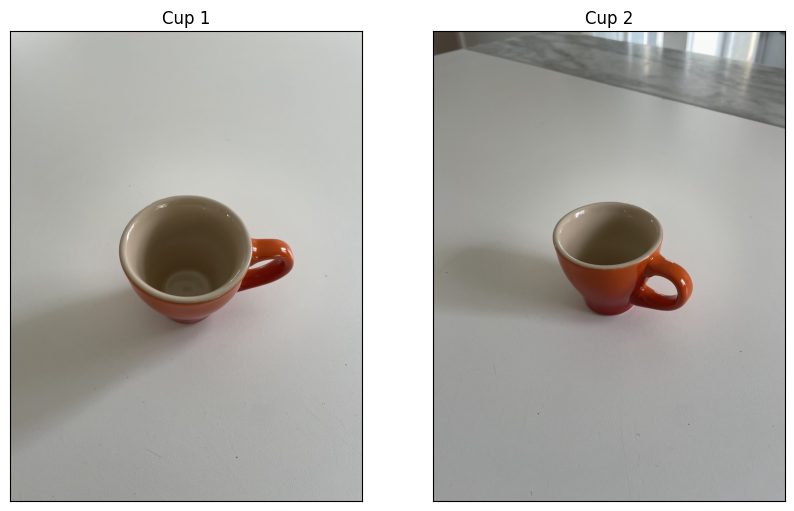

In [29]:
# Import pair of images captured in assignment 1
cup_1 = cv2.imread(path + "Data/Q2/Cup_1.jpg")
cup_2 = cv2.imread(path + "Data/Q2/Cup_2.jpg")

cup_1 = cv2.cvtColor(cup_1, cv2.COLOR_BGR2RGB)
cup_2 = cv2.cvtColor(cup_2, cv2.COLOR_BGR2RGB)

# display images
plt.figure(figsize=(10,10))
plt.subplot(121), plt.imshow(cup_1)
plt.title("Cup 1"), plt.xticks([]), plt.yticks([])
plt.subplot(122), plt.imshow(cup_2)
plt.title("Cup 2"), plt.xticks([]), plt.yticks([])
plt.show()

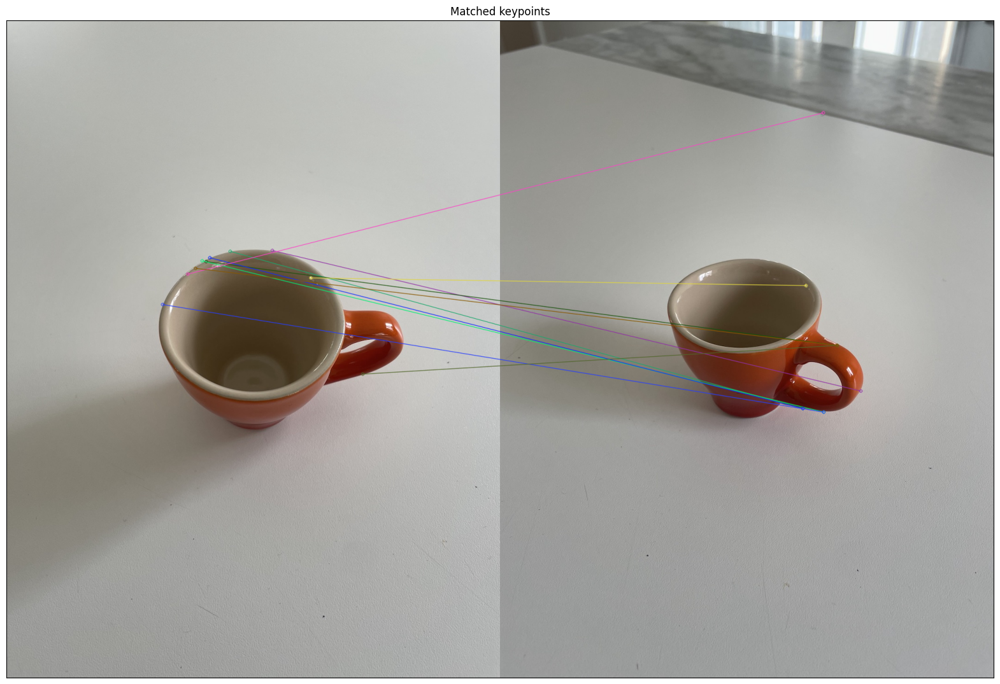

In [30]:
# 1. Compute SIFT keypoints for image_1 and image_2.

# Compute keypoints and descriptors
# Ref: https://docs.opencv.org/3.4/da/df5/tutorial_py_sift_intro.html
sift = cv2.xfeatures2d.SIFT_create()
keypoints_1, descriptors_1 = sift.detectAndCompute(cup_1, None)
keypoints_2, descriptors_2 = sift.detectAndCompute(cup_2, None)

# 2. Match all keypoints between two images using a brute-force method.

# create BFMatcher object with Euclidean distance (L2 norm) to match the SIFT descriptors between the two images.
# Ref: https://docs.opencv.org/3.4/d3/da1/classcv_1_1BFMatcher.html#ac6418c6f87e0e12a88979ea57980c020
bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=False)

# Match descriptors (query image, train image)
matches = bf.match(descriptors_1, descriptors_2)

# 3. Sort the matching keypoints according to the matching distance.

# Sort them in the order of their distance.
matches = sorted(matches, key = lambda x:x.distance)

# 4. Display the top ten matched keypoints.

# Draw first 10 matches.
imgmatch = cv2.drawMatches(cup_1,keypoints_1,cup_2,keypoints_2, matches[:10], None, flags=2)

# Plot
plt.figure(figsize=(20, 20))
plt.imshow(imgmatch)
plt.title("Matched keypoints"), plt.xticks([]), plt.yticks([])
plt.show()

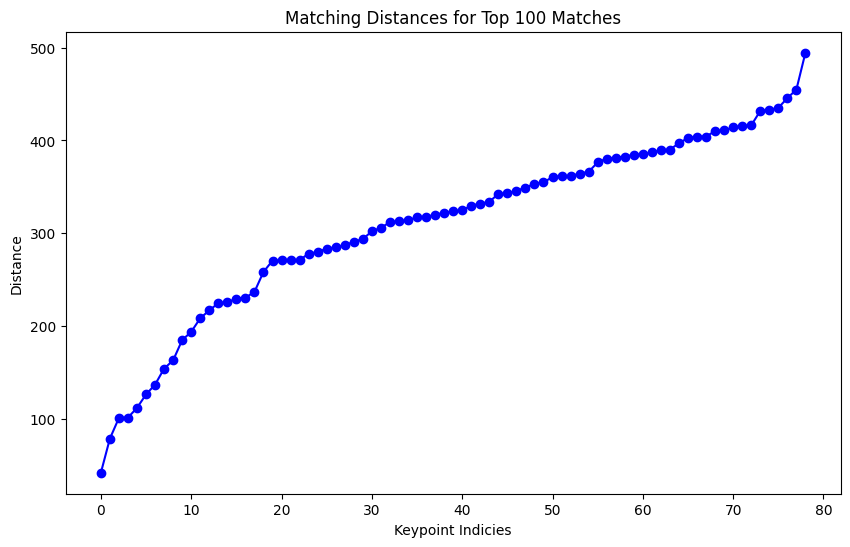

In [31]:
# 5. Plot the matching distance for the top 100 matched keypoints. Plot the indices of keypoints on the x-axis and the corresponding matching distance on the y-axis.

# Get distances for the top 100 matched keypoints
distances = [m.distance for m in matches[:100]]

# Plot
plt.figure(figsize=(10, 6))
plt.plot(distances, marker='o', linestyle='-', color='b')
plt.title('Matching Distances for Top 100 Matches')
plt.xlabel('Keypoint Indicies')
plt.ylabel('Distance')
plt.show()

## 2.3 - Invariance Under Scale
1. Compute SIFT keypoints for the image_1.
2. Scale image_1 using scaling factors of (0.25, 0.6, 3, 5). This should result in a total of 4
different transformed images. Display scaled images.
3. Compute SIFT keypoints for all scaled images (total 4) transformed images.
4. Match all keypoints of image_1 to the transformed images from the previous part using a brute-force method.
5. Sort the matching keypoints according to the matching distance.
6. Display the top ten matched keypoints for each pair of the image_1 and a transformed image.
7. Plot the matching distance for the top 100 matched keypoints. Plot the indices of keypoints on the x-axis and the corresponding matching distance on the y-axis.
8. Discuss the trend in the plotted results. What is the effect of increasing the scale on the matching distance? Explain.


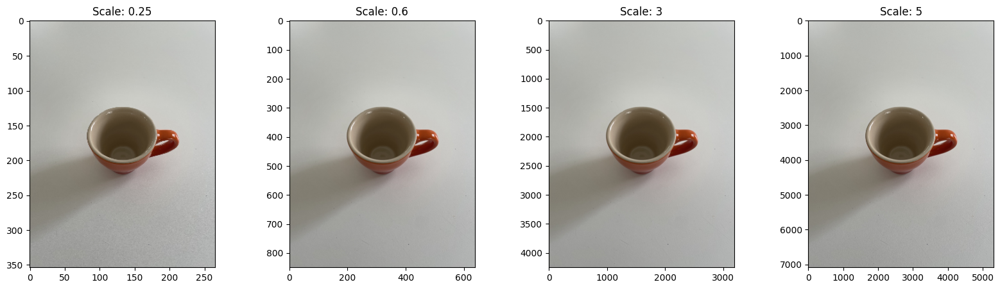

In [32]:
# 1. Compute SIFT keypoints for the image_1.

sift = cv2.xfeatures2d.SIFT_create()
keypoints_1, descriptors_1 = sift.detectAndCompute(cup_1, None)

# 2. Scale image_1 using scaling factors of (0.25, 0.6, 3, 5). This should result in a total of 4 different transformed images. Display scaled images.

# Resizing image, "scaled_cups" holds all resized images in order of "scaling_factors"
# Ref: https://www.geeksforgeeks.org/image-resizing-using-opencv-python/
scaling_factors = [0.25, 0.6, 3, 5]
scaled_cups = [cv2.resize(cup_1, None, fx=scale, fy=scale) for scale in scaling_factors]

# Plot
fig, axs = plt.subplots(1, 4, figsize=(20, 5))
for i, cup in enumerate(scaled_cups):
    axs[i].imshow(cup)
    axs[i].set_title("Scale: " + str(scaling_factors[i]))
plt.show()

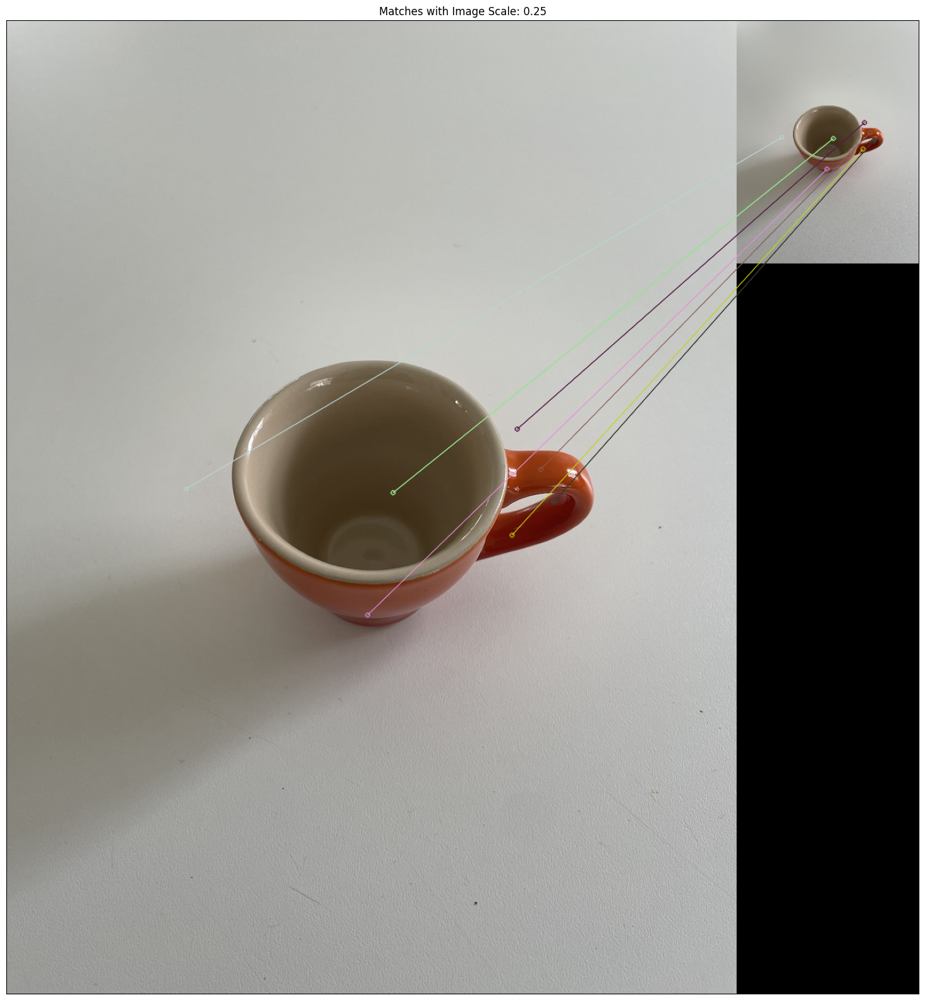

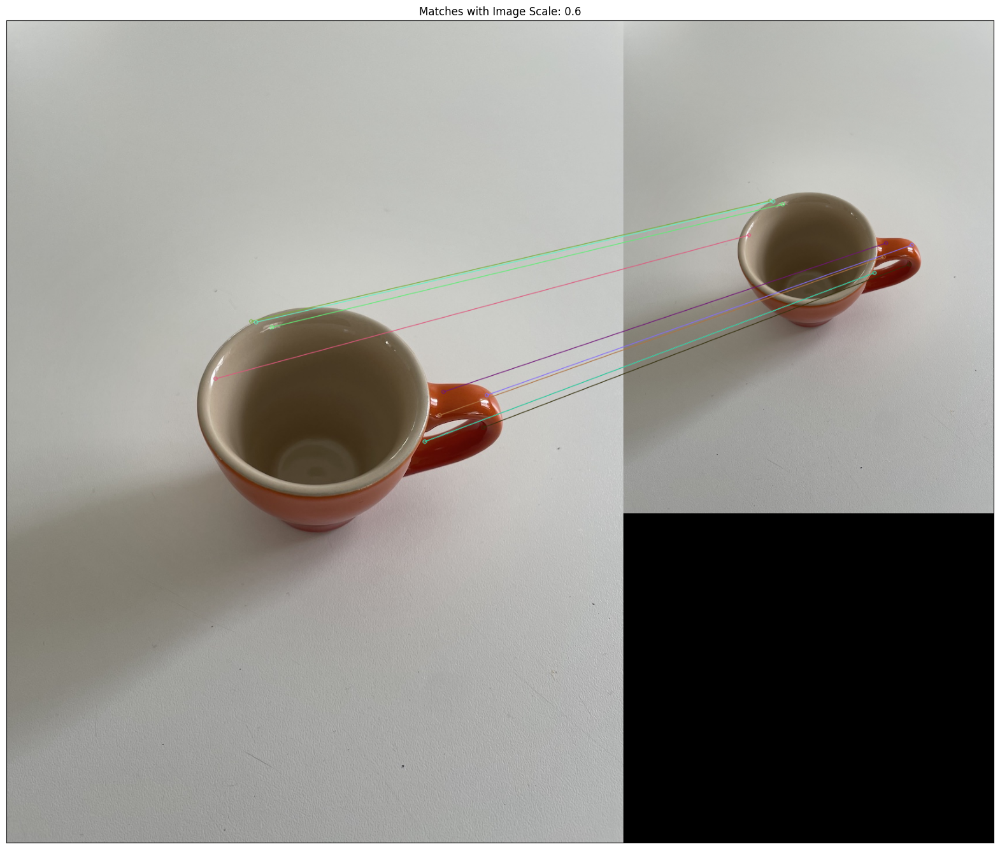

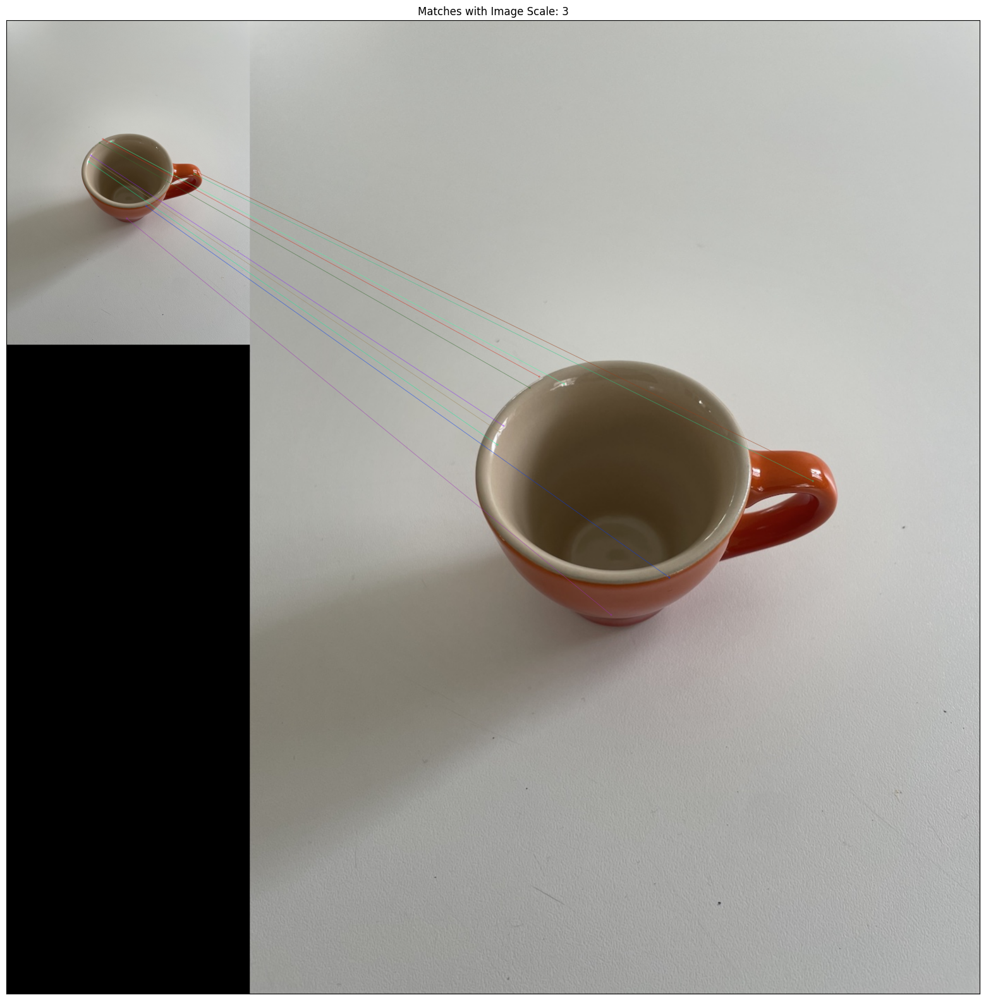

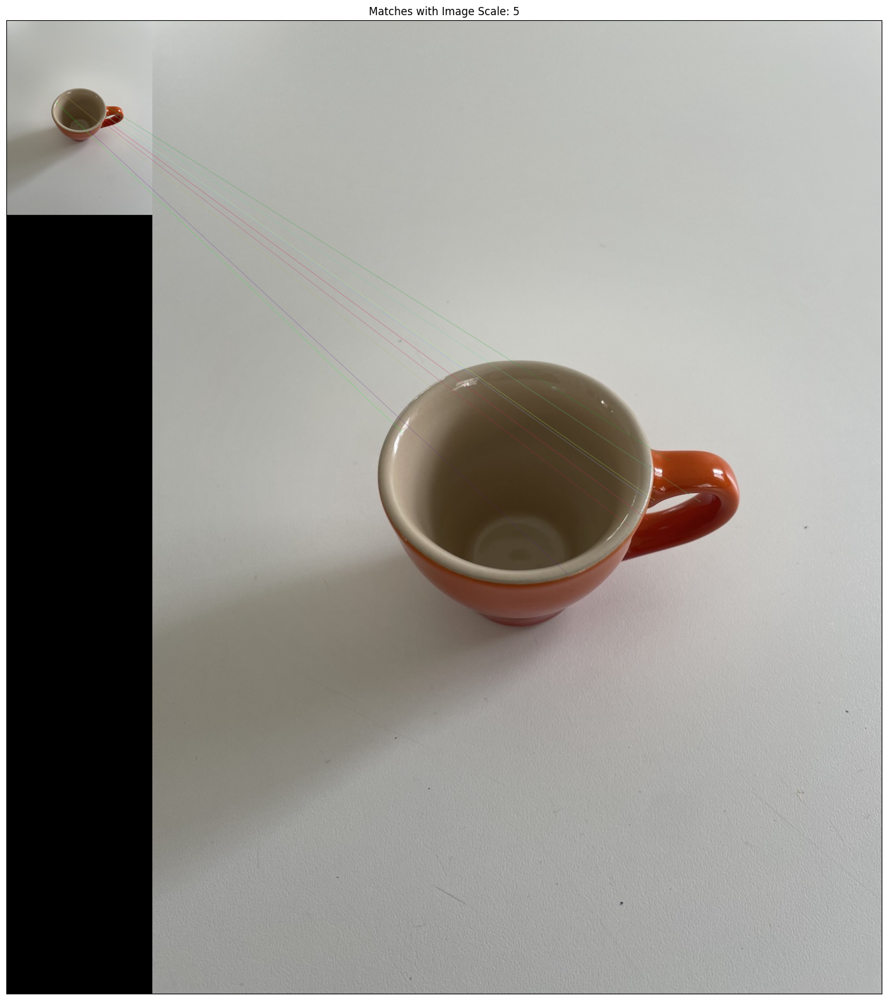

In [33]:
# 3. Compute SIFT keypoints for all scaled images (total 4) transformed images.

# keypoints_scaled holds keypoints, descriptors tuple for each scaled image in scaled_cups
keypoints_scaled = [sift.detectAndCompute(cup, None) for cup in scaled_cups]

# 4. Match all keypoints of image_1 to the transformed images from the previous part using a brute-force method.

# matches holds all matches between image_1 and each scaled image respectively
bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=False)
matches = [bf.match(descriptors_1, descriptors_scaled[1]) for descriptors_scaled in keypoints_scaled]

# 5. Sort the matching keypoints according to the matching distance.

sorted_matches = [sorted(m, key=lambda x: x.distance) for m in matches]

# 6. Display the top ten matched keypoints for each pair of the image_1 and a transformed image.

for i, match_scaled in enumerate(sorted_matches):
    img_matches = cv2.drawMatches(cup_1, keypoints_1, scaled_cups[i], keypoints_scaled[i][0], match_scaled[:10], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    plt.figure(figsize=(20, 20))
    plt.imshow(img_matches)
    plt.title("Matches with Image Scale: " + str(scaling_factors[i])), plt.xticks([]), plt.yticks([])
    plt.show()

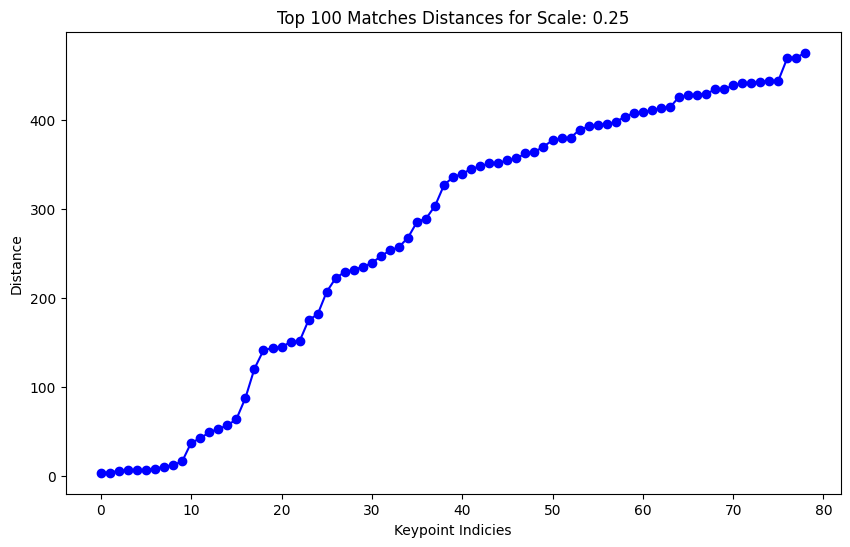

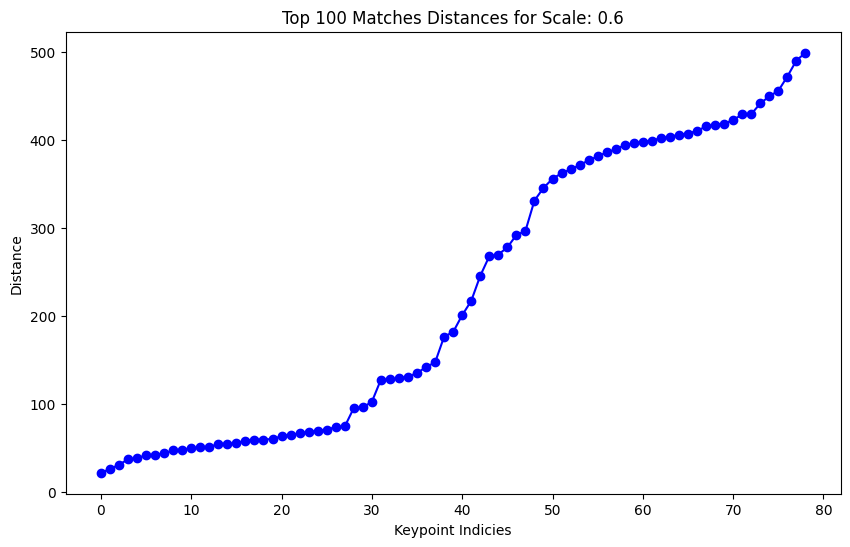

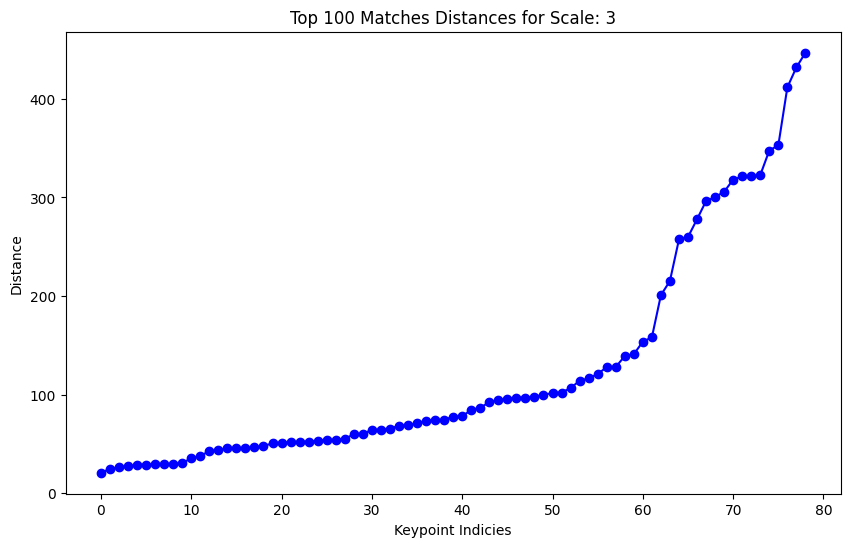

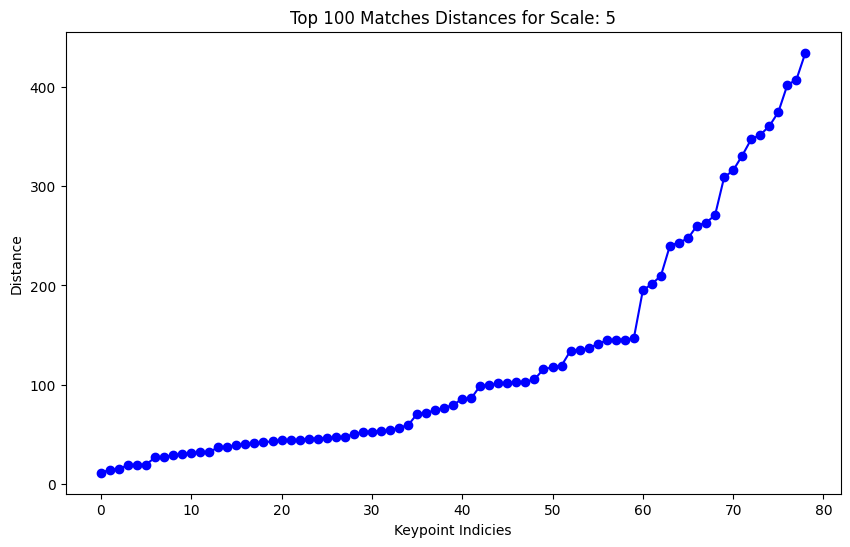

In [34]:
# 7. Plot the matching distance for the top 100 matched keypoints. Plot the indices of keypoints on the x-axis and the corresponding matching distance on the y-axis.

for i, match_scaled in enumerate(sorted_matches):
    distances = [m.distance for m in match_scaled[:100]]
    plt.figure(figsize=(10, 6))
    plt.plot(distances, marker='o', linestyle='-', color='b')
    plt.title("Top 100 Matches Distances for Scale: " + str(scaling_factors[i]))
    plt.xlabel('Keypoint Indicies')
    plt.ylabel('Distance')
    plt.show()

### 2.3.8 - Discuss the trend in the plotted results.

Low Scale Factors (0.25 and 0.6):
* The matching distance starts relatively low, indicating that many of the initial keypoints are still matching well despite the scaling.
* As we move towards higher keypoint indices (which correspond to matches with larger distances), we see a gradual increase. This indicates that some keypoints do not match as well after scaling down, possibly due to loss of detail or changes in appearance that affect the descriptor.

High Scale Factors (3 and 5):
* Similar to the lower scales, the initial keypoints (with lower indices) have low matching distances, suggesting good matches.
* The matching distance increases significantly for keypoints with higher indices. This increase is more pronounced for these higher scaling factors compared to the lower ones.
* The steeper slope in the distance curve at higher scaling factors indicates that more keypoints are not matching as well when the image is scaled up by these larger factors.

The trend across these graphs suggests that while the SIFT algorithm is designed to be scale-invariant, its performance in matching keypoints between images can degrade as the scaling factor moves further away from 1 (either downscaling or upscaling). The invariance has its limits, and extreme scaling can lead to less reliable feature matching.

## 2.4 - Invariance Under Rotation
1. Rotate image_1 at the angle of (30, 75, 90, 180). Display rotated images.
2. Compute SIFT keypoints for all (total 4) transformed images.
3. Match all keypoints of image_1 to the transformed images using a brute-force method.
4. Sort the matching keypoints according to the matching distance.
5. Display the top ten matched keypoints for each pair of image_1 and a transformed image.
6. Plot the matching distance for the top 100 matched keypoints. Plot the indices of the key points on the x-axis and the corresponding matching distance on the y-axis.
7. Discuss the trend in the plotted results. What is the effect of increasing the angle of rotation on the matching distance? Explain.

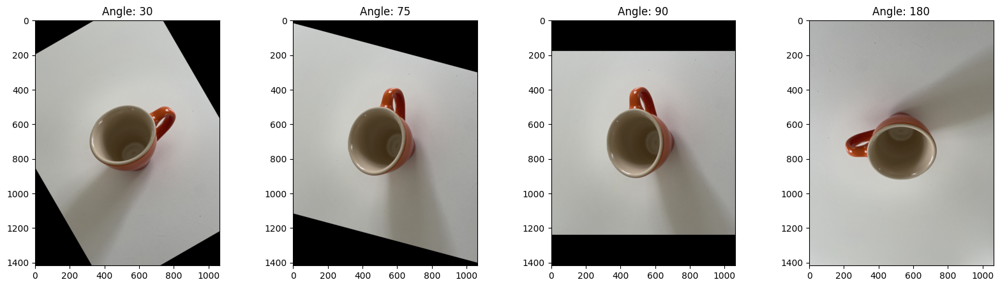

In [35]:
# 1. Rotate image_1 at the angle of (30, 75, 90, 180). Display rotated images.

# Rotating image, "rotated_cups" holds all rotated images in order of "angles"
# SIFT expects the input image to have a depth of CV_8U (unsigned 8-bit), need to adjust
# Ref: https://scikit-image.org/docs/stable/user_guide/geometrical_transform.html
angles = [30, 75, 90, 180]
rotated_cups = [ski.img_as_ubyte(ski.transform.rotate(cup_1, angle)) for angle in angles]

# Plot
fig, axs = plt.subplots(1, 4, figsize=(20, 5))
for i, cup in enumerate(rotated_cups):
    axs[i].imshow(cup)
    axs[i].set_title("Angle: " + str(angles[i]))
plt.show()

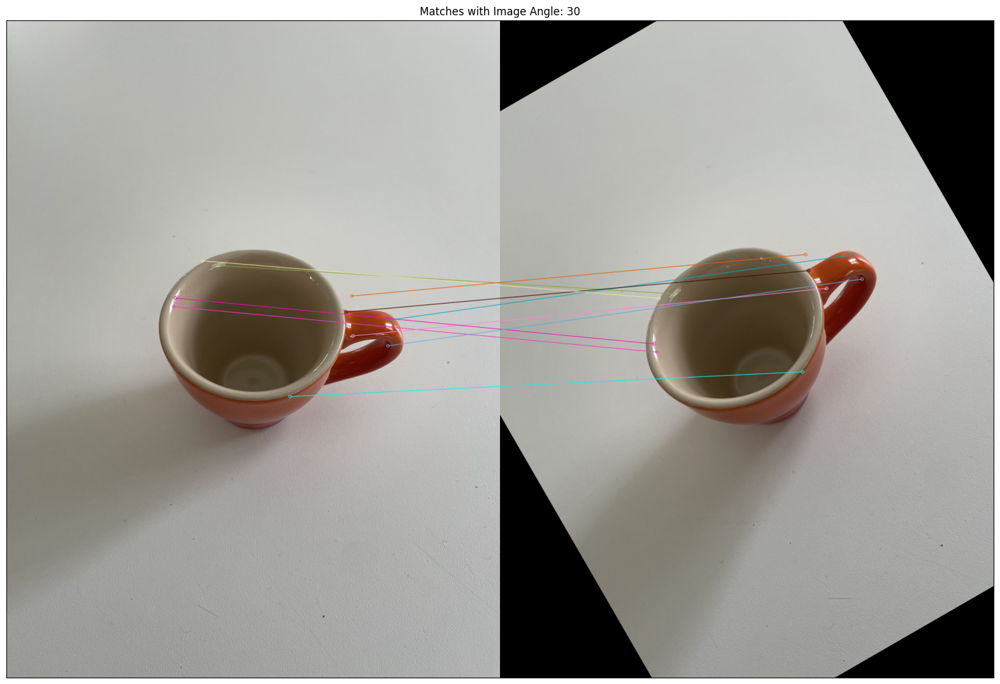

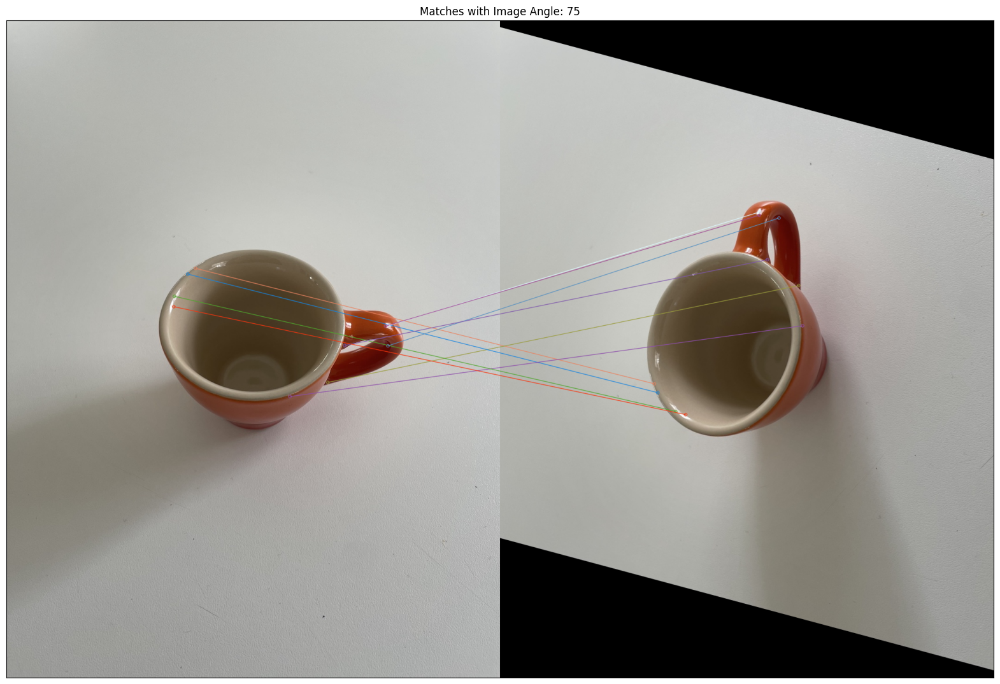

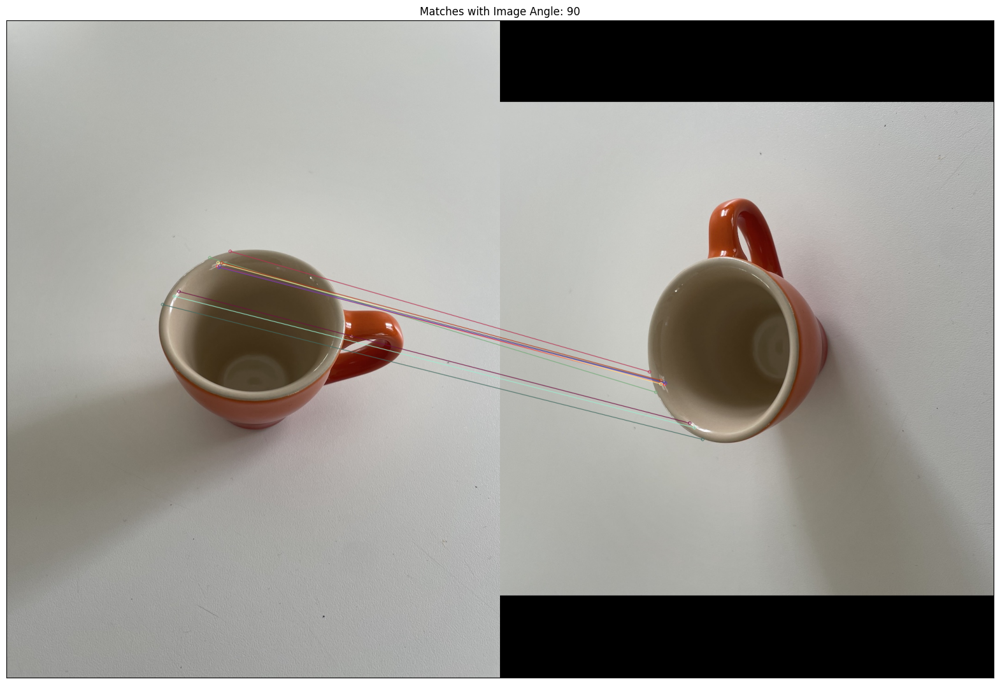

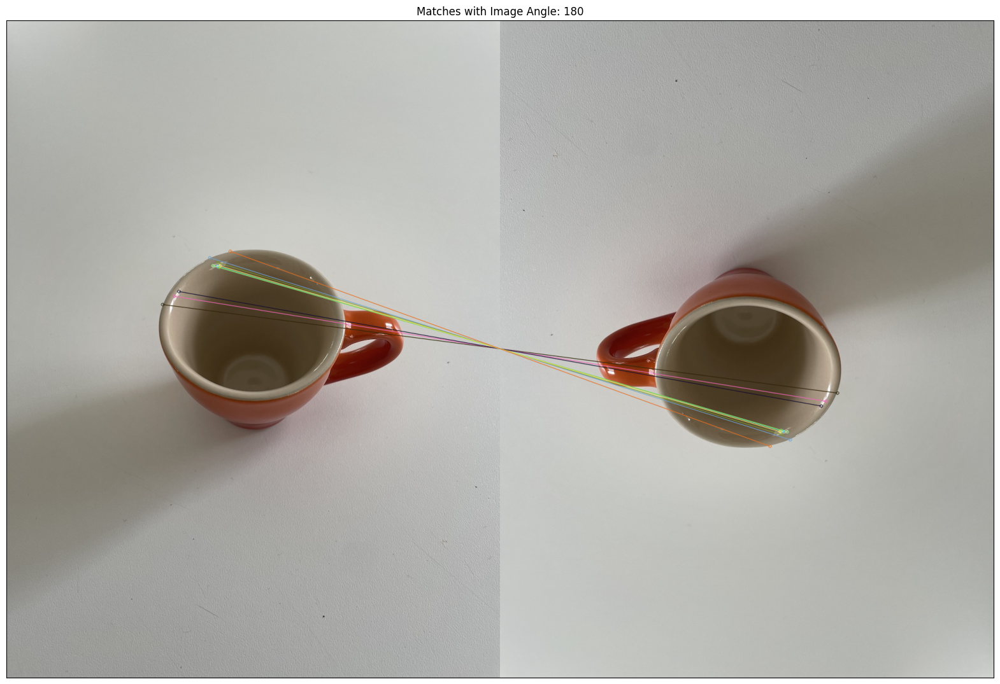

In [36]:
# 2. Compute SIFT keypoints for all (total 4) transformed images.

keypoints_rotated = [sift.detectAndCompute(cup, None) for cup in rotated_cups]

# 3. Match all keypoints of image_1 to the transformed images using a brute-force method.

bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=False)
matches = [bf.match(descriptors_1, descriptors_rotated[1]) for descriptors_rotated in keypoints_rotated]

# 4. Sort the matching keypoints according to the matching distance.

sorted_matches = [sorted(m, key=lambda x: x.distance) for m in matches]

# 5. Display the top ten matched keypoints for each pair of image_1 and a transformed image.

for i, match_rotated in enumerate(sorted_matches):
    img_matches = cv2.drawMatches(cup_1, keypoints_1, rotated_cups[i], keypoints_rotated[i][0], match_rotated[:10], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    plt.figure(figsize=(20, 20))
    plt.imshow(img_matches)
    plt.title("Matches with Image Angle: " + str(angles[i])), plt.xticks([]), plt.yticks([])
    plt.show()

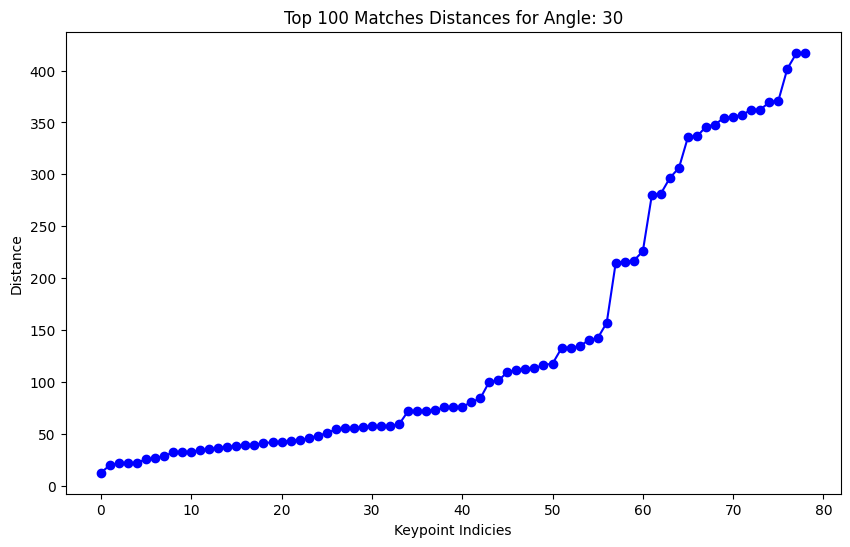

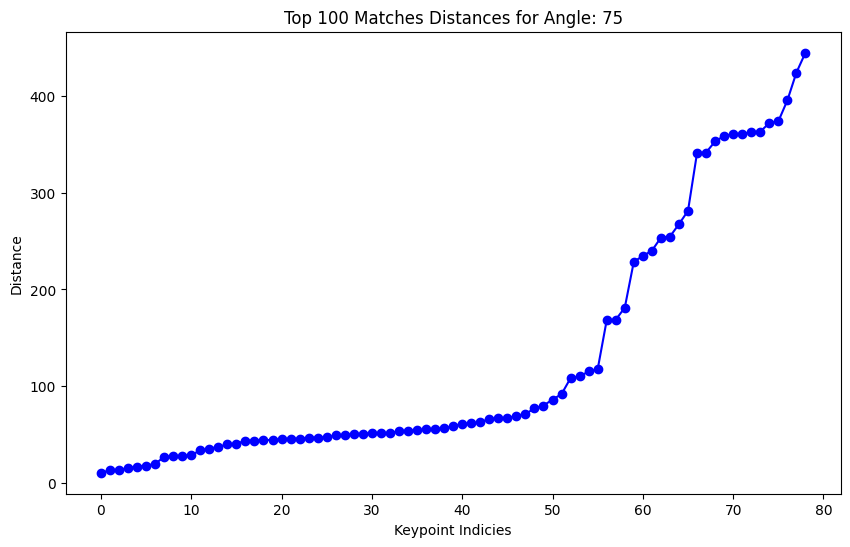

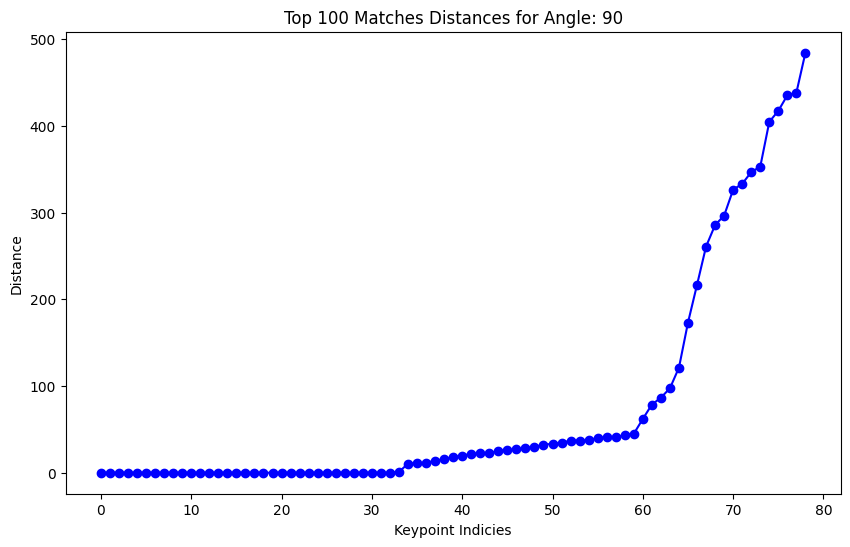

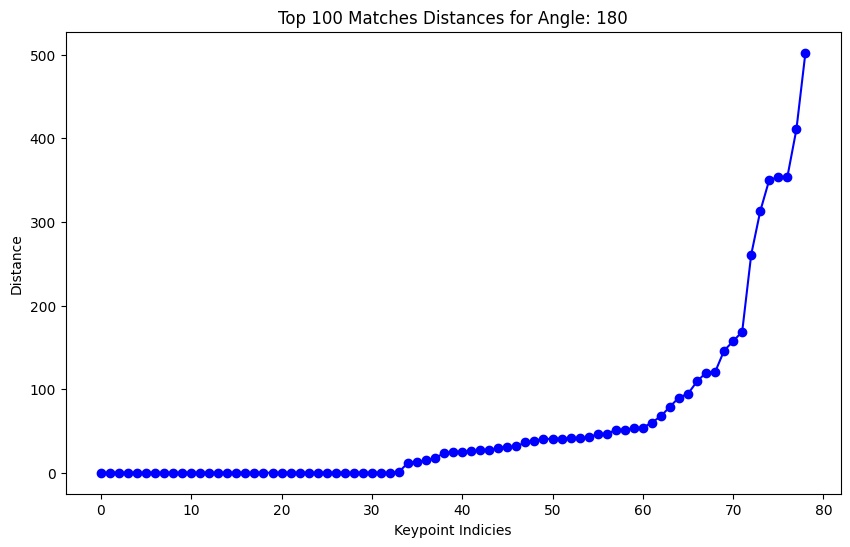

In [37]:
# 6. Plot the matching distance for the top 100 matched keypoints. Plot the indices of the key points on the x-axis and the corresponding matching distance on the y-axis.
for i, match_rotated in enumerate(sorted_matches):
    distances = [m.distance for m in match_rotated[:100]]
    plt.figure(figsize=(10, 6))
    plt.plot(distances, marker='o', linestyle='-', color='b')
    plt.title("Top 100 Matches Distances for Angle: " + str(angles[i]))
    plt.xlabel('Keypoint Indicies')
    plt.ylabel('Distance')
    plt.show()

### 2.4.7 - Discuss the trend in the plotted results.

* 30 Degrees: The graph starts with low matching distances, indicating good matches, and gradually increases. A steep rise in distance values is observed after approximately the 60th keypoint, suggesting that while many keypoints match well, there is a subset that doesn't match as closely.

* 75 Degrees: This graph also starts with low distances, but the distances begin to increase a bit earlier around the 50th keypoint. The overall trend is similar to the 30-degree rotation, but the distances become larger earlier in the sequence.

* 90 Degrees: The initial matching distances are again low, but like the 75-degree rotation, the increase in distances starts a bit earlier than in the 30-degree rotation. This suggests that as the angle increases, the matches become less accurate earlier in the sequence of keypoints.

* 180 Degrees: The distances for the 180-degree rotation remain low for the initial keypoints, similar to the other graphs. However, there is a noticeable increase in distance after the 40th keypoint, and the final distances are the highest among the four graphs. This indicates that the 180-degree rotation - a complete inversion of the image - leads to the poorest matches.

As the angle of rotation increases, the matching distances also increase, especially after a certain point in the sequence of keypoints. This indicates that keypoint matches become less accurate as the rotation angle increases. This shows SIFT keypoints are somewhat invariant to rotation, but the degree of invariance decreases as the rotation angle increases. The keypoints' matches are more accurate at lower rotation angles and become increasingly less accurate as the angle grows, particularly beyond certain thresholds which vary with the angle of rotation

# 3 - Image Stitching
Ref: Tutorial 4, [Source 1](https://datahacker.rs/005-how-to-create-a-panorama-image-using-opencv-with-python/)

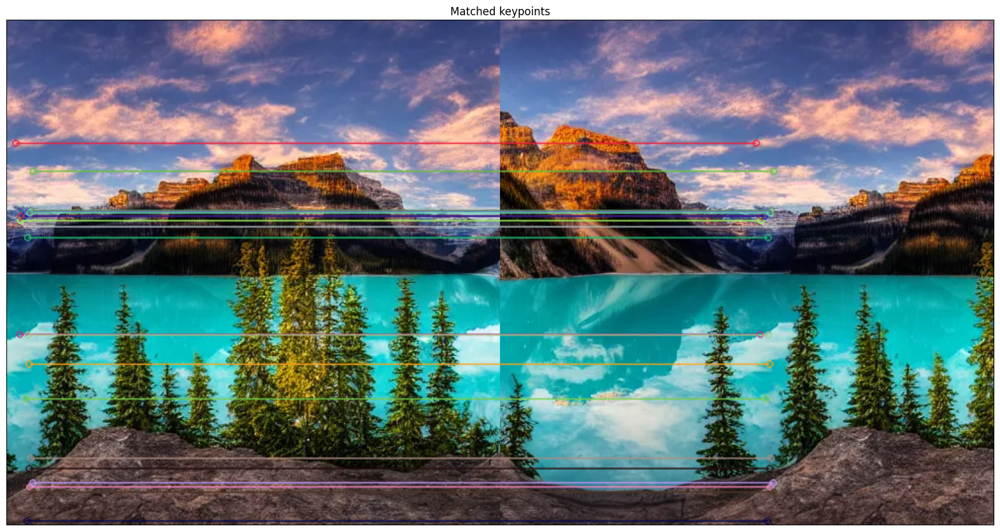

In [38]:
# (a) Compute the SIFT keypoints and corresponding descriptors for images 1 and 2.
part1 = cv2.imread(path + "Data/Q3/part1.png")
part2 = cv2.imread(path + "Data/Q3/part2.png")

part1 = cv2.cvtColor(part1, cv2.COLOR_BGR2RGB)
part2 = cv2.cvtColor(part2, cv2.COLOR_BGR2RGB)

sift = cv2.xfeatures2d.SIFT_create()
keypoints_1, descriptors_1 = sift.detectAndCompute(part1, None)
keypoints_2, descriptors_2 = sift.detectAndCompute(part2, None)

# (b) Find matching keypoints in images 1 and 2 and display the 20 best pairs.

# Match & Sort
bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=False)
matches = bf.match(descriptors_2, descriptors_1)
matches = sorted(matches, key = lambda x:x.distance)

# Draw first 20 matches.
imgmatch = cv2.drawMatches(part2,keypoints_2,part1,keypoints_1, matches[:20], None, flags=2)

# Plot
plt.figure(figsize=(20, 20))
plt.imshow(imgmatch)
plt.title("Matched keypoints"), plt.xticks([]), plt.yticks([])
plt.show()

In [39]:
# Helper function to remove black boarder after blend, used a hack instead of finding the intersection region of blend...
# Took inspiration from StackOverflow thread ... "add +1 to each channel. Warp each image to a common output such that the background is
# black and the rest is still non-black. Then make a mask for each image by changing (thresholding) all non-zero values to white.
# Use the bitwise_and() to find where the two image overlap."
# Ref: https://stackoverflow.com/questions/68118396/determine-the-region-of-overlap-after-stitching-in-opencv
def contour_mask(img):

    # IDEA -> Find the largest bounding rectangle, take width (image size without black boarder)
    # Ref: https://docs.opencv.org/4.x/d4/d73/tutorial_py_contours_begin.html
    # Ref: https://docs.opencv.org/4.x/dd/d49/tutorial_py_contour_features.html

    # Convert the image to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Threshold the grayscale image to create a binary mask, where white represents non-black areas
    _, binary_mask = cv2.threshold(gray, 1, 255, cv2.THRESH_BINARY)

    # Find the contours in the binary mask
    contours, _ = cv2.findContours(binary_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Assume the largest contour corresponds to the non-black region of the image
    largest_contour = max(contours, key=cv2.contourArea)

    # Get the x, y, width, and height of the bounding box of the largest contour
    x, y, w, h = cv2.boundingRect(largest_contour)

    return w

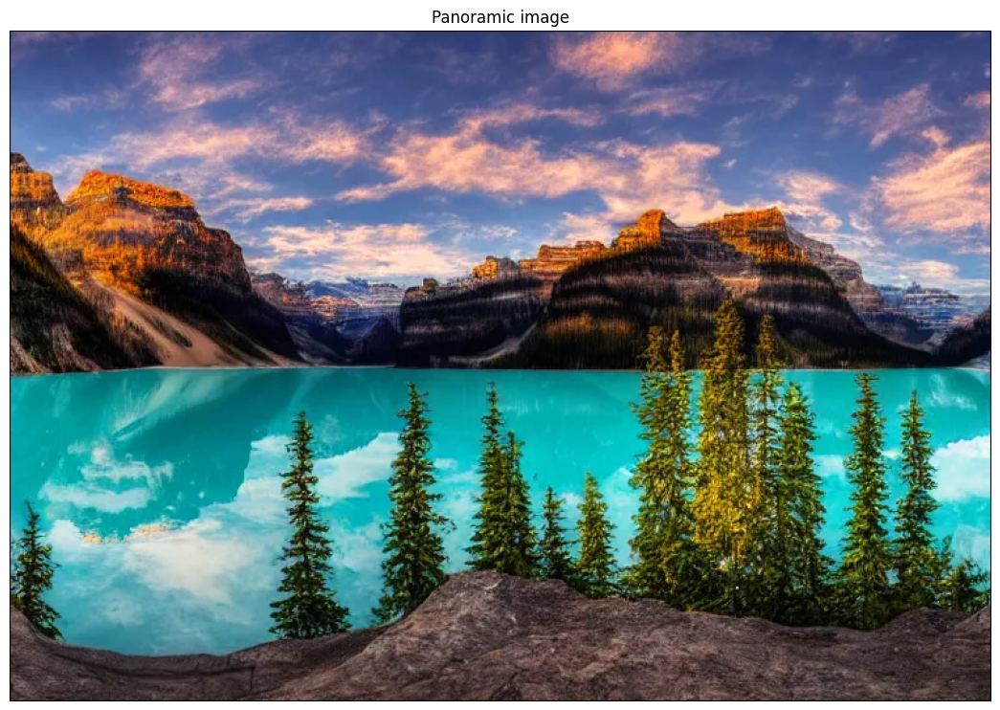

In [40]:
# (c) Find the homography that best matches the keypoints from image 1 and 2 using the RANSAC method, and apply the resulting transformation to image 1. Image 2 should not be transformed.
# Ref: https://docs.opencv.org/3.0-beta/doc/py_tutorials/py_feature2d/py_feature_homography/py_feature_homography.html

# Arrange matching keypoints in two separate lists
GoodMatches = []
for i, m in enumerate(matches):
    if m.distance < 1000:
        GoodMatches.append((m.trainIdx, m.queryIdx))

src_pts = np.float32([keypoints_2[i].pt for (_, i) in GoodMatches])
dst_pts = np.float32([keypoints_1[i].pt for (i, _) in GoodMatches])

# find homography and wrap image accordingly
# Ref: https://docs.opencv.org/2.4/modules/calib3d/doc/camera_calibration_and_3d_reconstruction.html#findhomography
H, _ = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 4)

# (d) Stitch the transformed image 1 and the original image 2 together using linear image blending. Let us call this image 12. Display this image.

# Shifting "part2"/image 2 to place on canvas where part1 & part2 overlap
# Ref: https://docs.opencv.org/master/da/d54/group__imgproc__transform.html#gaf73673a7e8e18ec6963e3774e6a94b87
img_12 = cv2.warpPerspective(part2, H, (part2.shape[1]+part1.shape[1],part2.shape[0]))
img_12[:,:part1.shape[1],:] = part1

# remove black - resize
max_width = contour_mask(img_12)
img_12 = img_12[:,:max_width,:]

plt.figure(figsize=(20,20))
plt.subplot(212)
plt.imshow(img_12)
plt.title("Panoramic image"), plt.xticks([]), plt.yticks([])
plt.show()

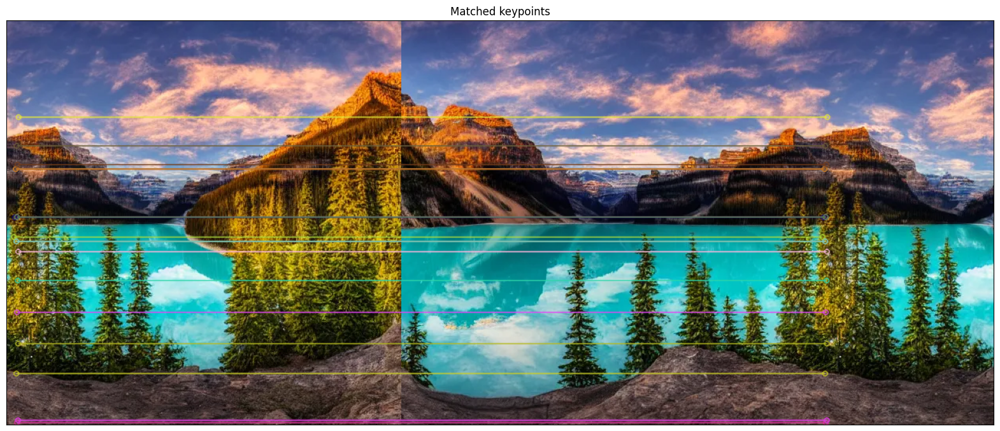

In [41]:
# (e) Compute the SIFT keypoints and corresponding descriptors for images 12 and 3.
part3 = cv2.imread(path + "Data/Q3/part3.png")
part3 = cv2.cvtColor(part3, cv2.COLOR_BGR2RGB)

keypoints_12, descriptors_12 = sift.detectAndCompute(img_12, None)
keypoints_3, descriptors_3 = sift.detectAndCompute(part3, None)

# (f) Find the matching keypoints in 12 and 3 images and display the 20 best pairs.

# Match & Sort
bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=False)
matches = bf.match(descriptors_3, descriptors_12)
matches = sorted(matches, key = lambda x:x.distance)

# Draw first 20 matches.
imgmatch = cv2.drawMatches(part3,keypoints_3,img_12,keypoints_12, matches[:20], None, flags=2)

# Plot
plt.figure(figsize=(20, 20))
plt.imshow(imgmatch)
plt.title("Matched keypoints"), plt.xticks([]), plt.yticks([])
plt.show()

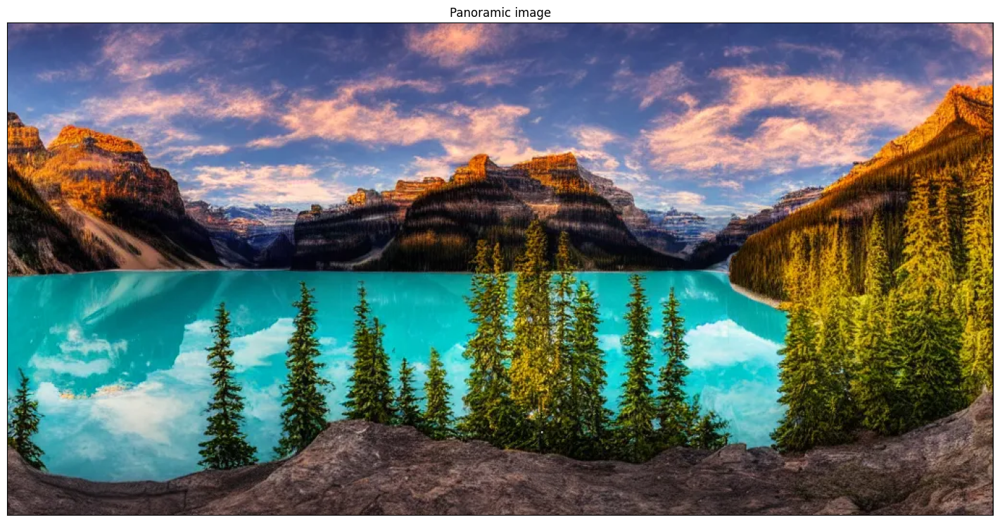

In [42]:
# (g) Compute the homography using the RANSAC method. Apply the transformation to image 3. Image 12 should not be transformed.

# Arrange matching keypoints in two separate lists
GoodMatches = []
for i, m in enumerate(matches):
    if m.distance < 1000:
        GoodMatches.append((m.trainIdx, m.queryIdx))

src_pts = np.float32([keypoints_3[i].pt for (_, i) in GoodMatches])
dst_pts = np.float32([keypoints_12[i].pt for (i, _) in GoodMatches])

# find homography and wrap image accordingly
# Ref: https://docs.opencv.org/2.4/modules/calib3d/doc/camera_calibration_and_3d_reconstruction.html#findhomography
H, _ = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 4)

# (h) Stitch the transformed image 3 and image 12 together using linear image blending. Display the resulting image.

# Ref: https://docs.opencv.org/master/da/d54/group__imgproc__transform.html#gaf73673a7e8e18ec6963e3774e6a94b87
img_123 = cv2.warpPerspective(part3, H, (part3.shape[1]+img_12.shape[1],part3.shape[0]))
img_123[:,:img_12.shape[1],:] = img_12

# Resize to remove black
max_width = contour_mask(img_123)
img_123 = img_123[:,:max_width,:]

plt.figure(figsize=(20,20))
plt.subplot(212)
plt.imshow(img_123)
plt.title("Panoramic image"), plt.xticks([]), plt.yticks([])
plt.show()

## 3.i - Discuss pyramid blending over linear blending?

Pyramid blending is better than linear blending in scenarios where you want to avoid visible seams and blend images more smoothly, especially in images with varying illumination or when objects/edges cross over the blend region.

Linear blending might result in visible seams or abrupt transitions because it applies the same blending ratio across the entire image. Pyramid blending, on the other hand, blends images at different scales or frequencies, allowing for a smoother transition between images by preserving the fine details in one image and the coarse structure in the other.

In the example given, since all images have the same illumination and generally all look identical other than their perspective, the benefits that could come from seamless blending are unnessesary.

Ref: [Source 1](https://docs.opencv.org/3.4/dc/dff/tutorial_py_pyramids.html), [Source 2](https://www.cs.toronto.edu/~guerzhoy/320/lec/blending.pdf)